# 火灾图像识别（原神启动）

#### 背景
* 该数据集来自2018年NASA太空应用挑战赛，目标是使用该数据集训练识别图中是否起火的模型。

#### 数据集内容
* 该数据是为了训练区分包含火灾的图像(火灾图像)和常规图像(非火灾图像)，所以是二分类数据集。

* 数据分为2个文件夹，fire_images文件夹包含755张户外火灾图像，其中一些包含浓烟，另一个是非火灾图像，其中包含244张自然图像(例如:森林、树、草、河流、人、雾森林、湖泊、动物、道路和瀑布)。

* 注意:数据量并不对等，两个类型(文件夹)的样本数量不相等，因此构建验证集时保证每个类型的图像数量相等(例如:40张火灾和非火灾的图像)。

# 包和依赖

In [1]:
#常规包
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
#路径处理
import os
import os.path
from pathlib import Path
import glob
#图片处理
from PIL import Image
from keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import cv2
from keras.applications.vgg16 import preprocess_input, decode_predictions
#预处理
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from keras.utils.np_utils import to_categorical
from sklearn.model_selection import train_test_split
from keras import regularizers
from sklearn.preprocessing import LabelEncoder
#准确性控制
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, roc_auc_score, roc_curve
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score
#OPTIMIZER
from keras.optimizers import RMSprop,Adam,Optimizer,Optimizer
#优化器
from tensorflow.keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPool2D, BatchNormalization,MaxPooling2D,BatchNormalization,\
                        Permute, TimeDistributed, Bidirectional,GRU, SimpleRNN, LSTM, GlobalAveragePooling2D, SeparableConv2D
from keras import models
from keras import layers
import tensorflow as tf
from keras.applications import VGG16,VGG19,inception_v3
from keras import backend as K
from keras.utils import plot_model
#SKLEARN分类器
from xgboost import XGBClassifier, XGBRegressor
from lightgbm import LGBMClassifier, LGBMRegressor
from catboost import CatBoostClassifier, CatBoostRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.ensemble import GradientBoostingClassifier, GradientBoostingRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.neural_network import MLPClassifier, MLPRegressor
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.linear_model import LinearRegression
from sklearn.cross_decomposition import PLSRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import RidgeCV
from sklearn.linear_model import Lasso
from sklearn.linear_model import LassoCV
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import ElasticNetCV
#警告
from warnings import filterwarnings
filterwarnings("ignore",category=DeprecationWarning)
filterwarnings("ignore", category=FutureWarning) 
filterwarnings("ignore", category=UserWarning)

# 路径和标签

#### 主要路径

In [2]:
Fire_Dataset_Path = Path("./input/fire-dataset/fire_dataset")

#### 具体文件

In [3]:
PNG_Path = list(Fire_Dataset_Path.glob(r"*/*.png"))

#### 标签

In [4]:
PNG_Labels = list(map(lambda x: os.path.split(os.path.split(x)[0])[1],PNG_Path))

In [5]:
print("FIRE: ", PNG_Labels.count("fire_images"))
print("NO_FIRE: ", PNG_Labels.count("non_fire_images"))

FIRE:  755
NO_FIRE:  244


# 转换成 series 序列

In [6]:
PNG_Path_Series = pd.Series(PNG_Path,name="PNG").astype(str)
PNG_Labels_Series = pd.Series(PNG_Labels,name="CATEGORY")

In [7]:
print(PNG_Path_Series)

0      input\fire-dataset\fire_dataset\fire_images\fi...
1      input\fire-dataset\fire_dataset\fire_images\fi...
2      input\fire-dataset\fire_dataset\fire_images\fi...
3      input\fire-dataset\fire_dataset\fire_images\fi...
4      input\fire-dataset\fire_dataset\fire_images\fi...
                             ...                        
994    input\fire-dataset\fire_dataset\non_fire_image...
995    input\fire-dataset\fire_dataset\non_fire_image...
996    input\fire-dataset\fire_dataset\non_fire_image...
997    input\fire-dataset\fire_dataset\non_fire_image...
998    input\fire-dataset\fire_dataset\non_fire_image...
Name: PNG, Length: 999, dtype: object


In [8]:
print(PNG_Labels_Series)

0          fire_images
1          fire_images
2          fire_images
3          fire_images
4          fire_images
            ...       
994    non_fire_images
995    non_fire_images
996    non_fire_images
997    non_fire_images
998    non_fire_images
Name: CATEGORY, Length: 999, dtype: object


In [9]:
PNG_Labels_Series.replace({"non_fire_images":"NO_FIRE","fire_images":"FIRE"},inplace=True)

In [10]:
print(PNG_Labels_Series)

0         FIRE
1         FIRE
2         FIRE
3         FIRE
4         FIRE
        ...   
994    NO_FIRE
995    NO_FIRE
996    NO_FIRE
997    NO_FIRE
998    NO_FIRE
Name: CATEGORY, Length: 999, dtype: object


# 转换成 DATAFRAME 结构

In [11]:
Main_Train_Data = pd.concat([PNG_Path_Series,PNG_Labels_Series],axis=1)

In [12]:
print(Main_Train_Data.head(-1))

                                                   PNG CATEGORY
0    input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
1    input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
2    input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
3    input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
4    input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
..                                                 ...      ...
993  input\fire-dataset\fire_dataset\non_fire_image...  NO_FIRE
994  input\fire-dataset\fire_dataset\non_fire_image...  NO_FIRE
995  input\fire-dataset\fire_dataset\non_fire_image...  NO_FIRE
996  input\fire-dataset\fire_dataset\non_fire_image...  NO_FIRE
997  input\fire-dataset\fire_dataset\non_fire_image...  NO_FIRE

[998 rows x 2 columns]


#### 打乱数据

In [13]:
Main_Train_Data = Main_Train_Data.sample(frac=1).reset_index(drop=True)

In [14]:
print(Main_Train_Data.head(-1))

                                                   PNG CATEGORY
0    input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
1    input\fire-dataset\fire_dataset\non_fire_image...  NO_FIRE
2    input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
3    input\fire-dataset\fire_dataset\non_fire_image...  NO_FIRE
4    input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
..                                                 ...      ...
993  input\fire-dataset\fire_dataset\non_fire_image...  NO_FIRE
994  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
995  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
996  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
997  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE

[998 rows x 2 columns]


In [15]:
print(Main_Train_Data["PNG"][2])
print(Main_Train_Data["CATEGORY"][2])
print(Main_Train_Data["PNG"][200])
print(Main_Train_Data["CATEGORY"][200])
print(Main_Train_Data["PNG"][45])
print(Main_Train_Data["CATEGORY"][45])
print(Main_Train_Data["PNG"][852])
print(Main_Train_Data["CATEGORY"][852])

input\fire-dataset\fire_dataset\fire_images\fire.593.png
FIRE
input\fire-dataset\fire_dataset\non_fire_images\non_fire.214.png
NO_FIRE
input\fire-dataset\fire_dataset\fire_images\fire.7.png
FIRE
input\fire-dataset\fire_dataset\non_fire_images\non_fire.186.png
NO_FIRE


发现non_fire.189.png是动图

In [16]:
remove_PNG = './input/fire-dataset/fire_dataset/non_fire_images/non_fire.189.png'
Main_Train_Data = Main_Train_Data.loc[~(Main_Train_Data.loc[:,'PNG'] == remove_PNG),:]

In [17]:
print(Main_Train_Data.loc[Main_Train_Data.loc[:,'PNG'] == remove_PNG,:])

Empty DataFrame
Columns: [PNG, CATEGORY]
Index: []


In [18]:
print(Main_Train_Data.head(-1))

                                                   PNG CATEGORY
0    input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
1    input\fire-dataset\fire_dataset\non_fire_image...  NO_FIRE
2    input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
3    input\fire-dataset\fire_dataset\non_fire_image...  NO_FIRE
4    input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
..                                                 ...      ...
993  input\fire-dataset\fire_dataset\non_fire_image...  NO_FIRE
994  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
995  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
996  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
997  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE

[998 rows x 2 columns]


# 数据集可视化

In [19]:
plt.style.use("dark_background")

#### 总览

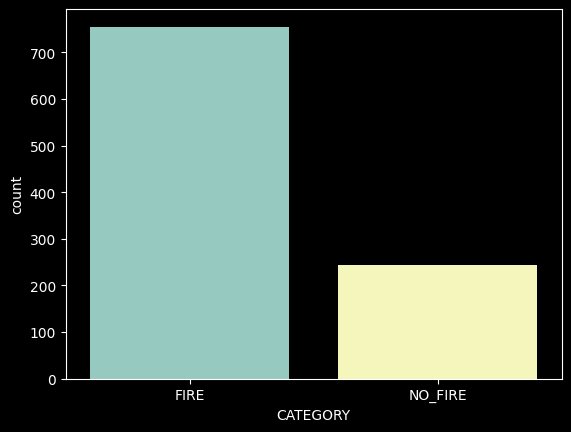

In [20]:
sns.countplot(Main_Train_Data["CATEGORY"])
plt.show()

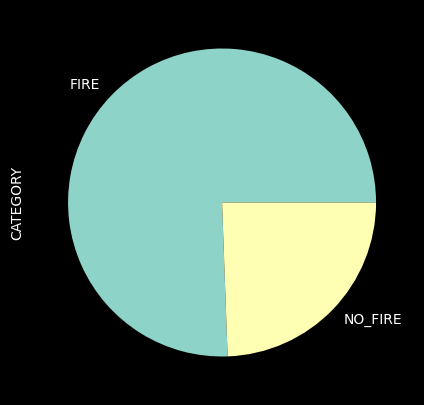

In [21]:
Main_Train_Data['CATEGORY'].value_counts().plot.pie(figsize=(5,5))
plt.show()

#### 图像

Text(0.5, 1.0, 'FIRE')

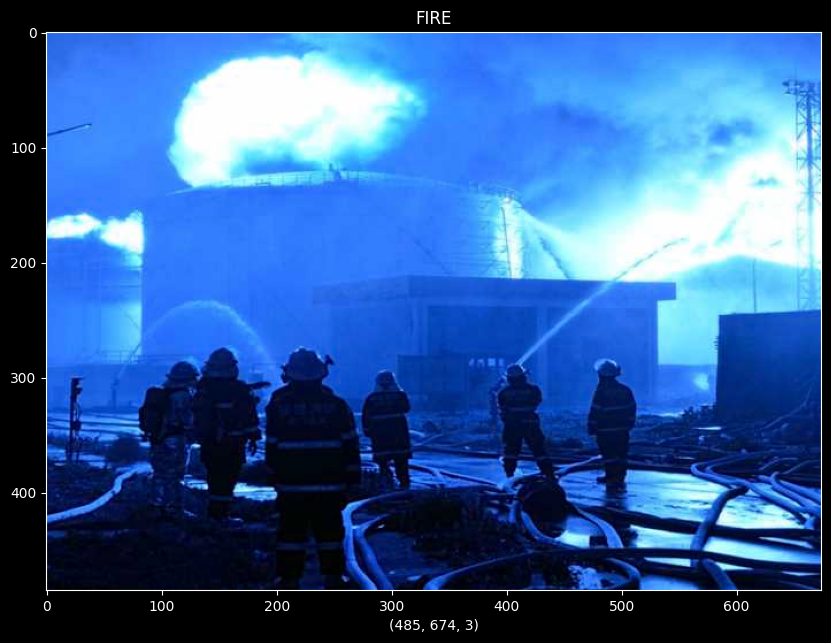

In [22]:
figure = plt.figure(figsize=(10,10))
x = cv2.imread(Main_Train_Data["PNG"][0])
plt.imshow(x)
plt.xlabel(x.shape)
plt.title(Main_Train_Data["CATEGORY"][0])

Text(0.5, 1.0, 'NO_FIRE')

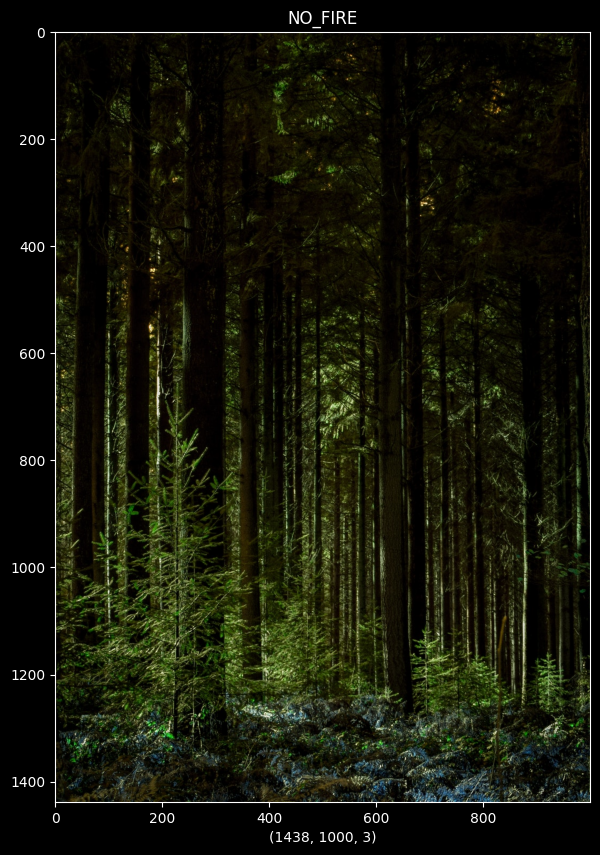

In [23]:
figure = plt.figure(figsize=(10,10))
x = cv2.imread(Main_Train_Data["PNG"][993])
plt.imshow(x)
plt.xlabel(x.shape)
plt.title(Main_Train_Data["CATEGORY"][993])

Text(0.5, 1.0, 'NO_FIRE')

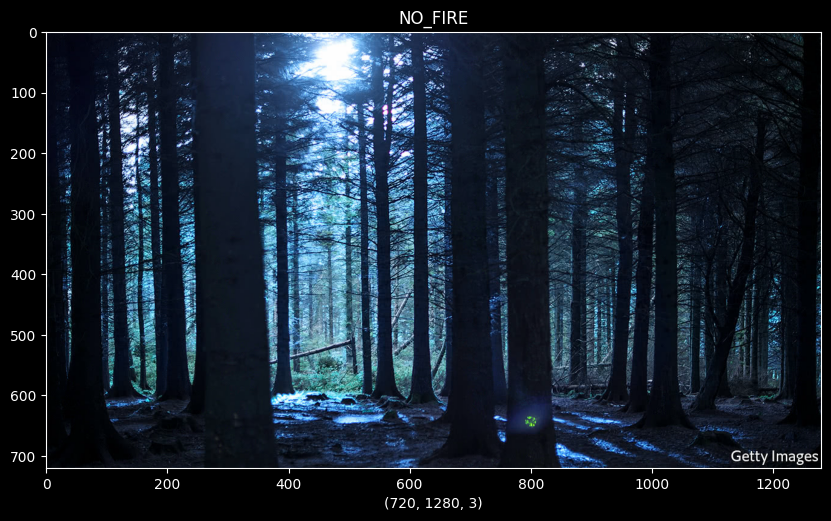

In [24]:
figure = plt.figure(figsize=(10,10))
x = cv2.imread(Main_Train_Data["PNG"][20])
plt.imshow(x)
plt.xlabel(x.shape)
plt.title(Main_Train_Data["CATEGORY"][20])

Text(0.5, 1.0, 'FIRE')

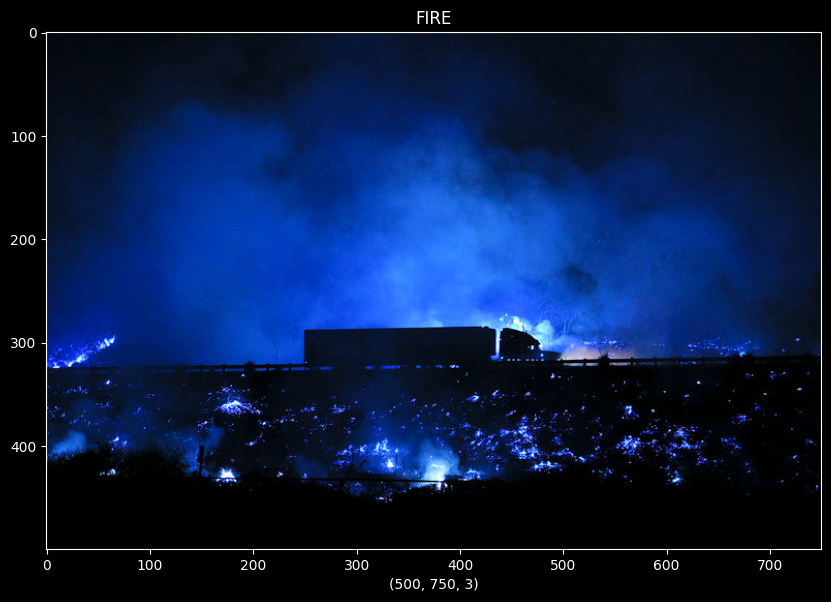

In [25]:
figure = plt.figure(figsize=(10,10))
x = cv2.imread(Main_Train_Data["PNG"][48])
plt.imshow(x)
plt.xlabel(x.shape)
plt.title(Main_Train_Data["CATEGORY"][48])

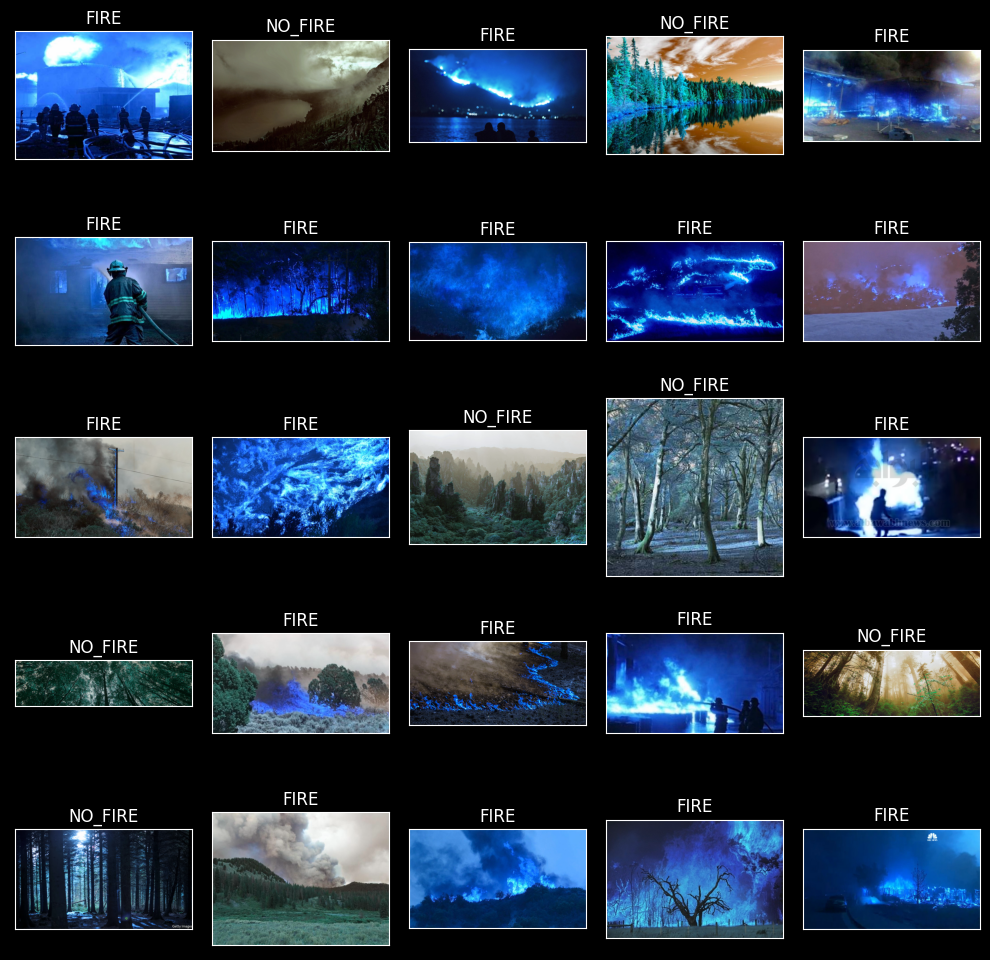

In [26]:
fig, axes = plt.subplots(nrows=5,
                        ncols=5,
                        figsize=(10,10),
                        subplot_kw={"xticks":[],"yticks":[]})

for i,ax in enumerate(axes.flat):
    ax.imshow(cv2.imread(Main_Train_Data["PNG"][i]))
    ax.set_title(Main_Train_Data["CATEGORY"][i])
plt.tight_layout()
plt.show()

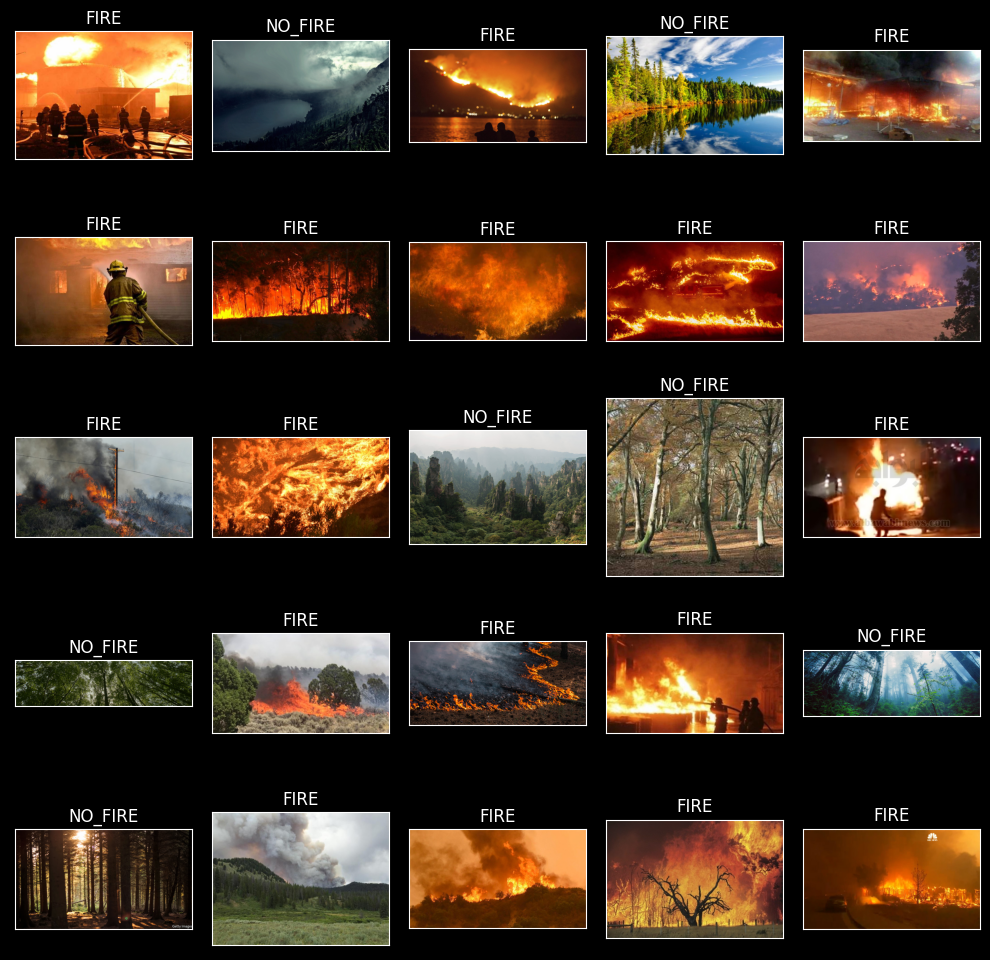

In [27]:
fig, axes = plt.subplots(nrows=5,
                        ncols=5,
                        figsize=(10,10),
                        subplot_kw={"xticks":[],"yticks":[]})

for i,ax in enumerate(axes.flat):
    x = cv2.imread(Main_Train_Data["PNG"][i])
    x = cv2.cvtColor(x,cv2.COLOR_RGB2BGR)
    ax.imshow(x)
    ax.set_title(Main_Train_Data["CATEGORY"][i])
plt.tight_layout()
plt.show()

# 训练集和测试集

#### 图像处理

In [28]:
Train_Generator = ImageDataGenerator(rescale=1./255,
                                    shear_range=0.3,
                                    zoom_range=0.2,
                                    brightness_range=[0.2,0.9],
                                    rotation_range=30,
                                    horizontal_flip=True,
                                    vertical_flip=True,
                                    fill_mode="nearest",
                                    validation_split=0.1)

In [29]:
Test_Generator = ImageDataGenerator(rescale=1./255)

#### 拆分训练集和测试集

In [30]:
Train_Data,Test_Data = train_test_split(Main_Train_Data,train_size=0.9,random_state=42,shuffle=True)

In [31]:
print("TRAIN SHAPE: ",Train_Data.shape)
print("TEST SHAPE: ",Test_Data.shape)

TRAIN SHAPE:  (899, 2)
TEST SHAPE:  (100, 2)


In [32]:
print(Train_Data.head(-1))
print("----"*20)
print(Test_Data.head(-1))

                                                   PNG CATEGORY
599  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
432  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
221  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
973  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
525  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
..                                                 ...      ...
71   input\fire-dataset\fire_dataset\non_fire_image...  NO_FIRE
106  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE
270  input\fire-dataset\fire_dataset\non_fire_image...  NO_FIRE
860  input\fire-dataset\fire_dataset\non_fire_image...  NO_FIRE
435  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE

[898 rows x 2 columns]
--------------------------------------------------------------------------------
                                                   PNG CATEGORY
453  input\fire-dataset\fire_dataset\fire_images\fi...     FIRE

In [33]:
print(Test_Data["CATEGORY"].value_counts())

FIRE       75
NO_FIRE    25
Name: CATEGORY, dtype: int64


In [34]:
encode = LabelEncoder()

In [35]:
For_Prediction_Class = encode.fit_transform(Test_Data["CATEGORY"])

#### 生成图片示例

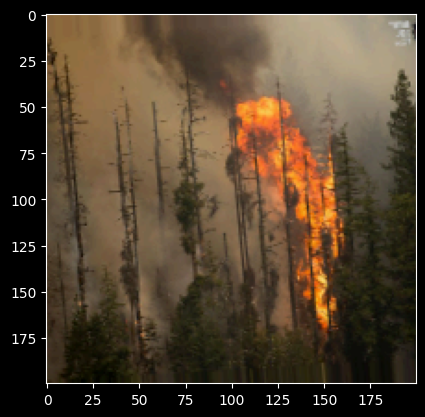

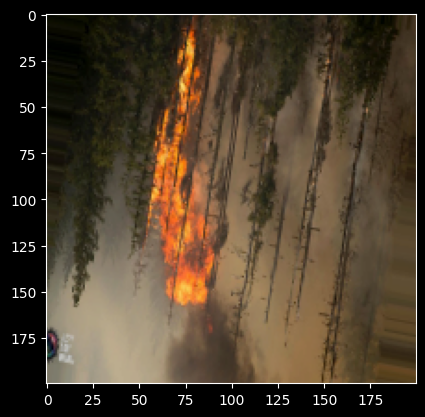

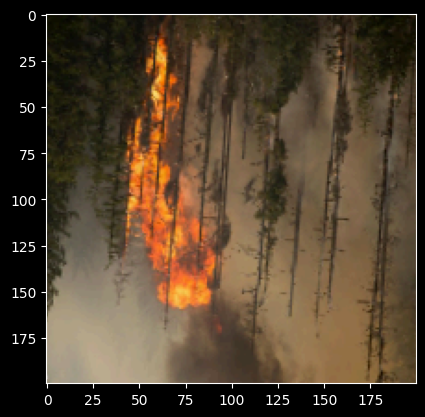

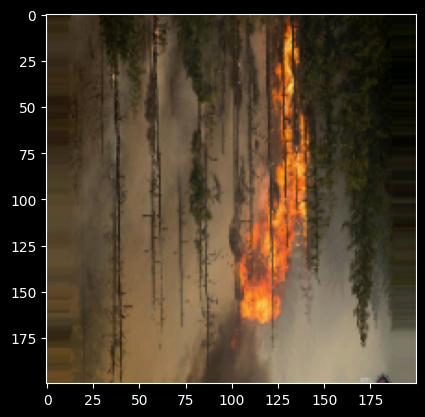

In [36]:
example_Image = Train_Data["PNG"][99]
Load_Image = image.load_img(example_Image,target_size=(200,200))
Array_Image = image.img_to_array(Load_Image)
Array_Image = Array_Image.reshape((1,) + Array_Image.shape)

i = 0
for batch in Train_Generator.flow(Array_Image,batch_size=1):
    plt.figure(i)
    IMG = plt.imshow(image.array_to_img(batch[0]))
    i += 1
    if i % 4 == 0:
        break
plt.show()

#### 转化图像

In [37]:
Train_IMG_Set = Train_Generator.flow_from_dataframe(dataframe=Train_Data,
                                                   x_col="PNG",
                                                   y_col="CATEGORY",
                                                   color_mode="rgb",
                                                   class_mode="categorical",
                                                   batch_size=32,
                                                   subset="training")

Found 810 validated image filenames belonging to 2 classes.


In [38]:
Validation_IMG_Set = Train_Generator.flow_from_dataframe(dataframe=Train_Data,
                                                   x_col="PNG",
                                                   y_col="CATEGORY",
                                                   color_mode="rgb",
                                                   class_mode="categorical",
                                                   batch_size=32,
                                                   subset="validation")

Found 89 validated image filenames belonging to 2 classes.


In [39]:
Test_IMG_Set = Test_Generator.flow_from_dataframe(dataframe=Test_Data,
                                                 x_col="PNG",
                                                 y_col="CATEGORY",
                                                 color_mode="rgb",
                                                 class_mode="categorical",
                                                 batch_size=32)

Found 100 validated image filenames belonging to 2 classes.


#### 检查

In [40]:
for data_batch,label_batch in Train_IMG_Set:
    print("DATA SHAPE: ",data_batch.shape)
    print("LABEL SHAPE: ",label_batch.shape)
    break

DATA SHAPE:  (32, 256, 256, 3)
LABEL SHAPE:  (32, 2)


In [41]:
for data_batch,label_batch in Validation_IMG_Set:
    print("DATA SHAPE: ",data_batch.shape)
    print("LABEL SHAPE: ",label_batch.shape)
    break

DATA SHAPE:  (32, 256, 256, 3)
LABEL SHAPE:  (32, 2)


In [42]:
for data_batch,label_batch in Test_IMG_Set:
    print("DATA SHAPE: ",data_batch.shape)
    print("LABEL SHAPE: ",label_batch.shape)
    break

DATA SHAPE:  (32, 256, 256, 3)
LABEL SHAPE:  (32, 2)


In [43]:
print("TRAIN: ")
print(Train_IMG_Set.class_indices)
print(Train_IMG_Set.classes[0:5])
print(Train_IMG_Set.image_shape)
print("---"*20)
print("VALIDATION: ")
print(Validation_IMG_Set.class_indices)
print(Validation_IMG_Set.classes[0:5])
print(Validation_IMG_Set.image_shape)
print("---"*20)
print("TEST: ")
print(Test_IMG_Set.class_indices)
print(Test_IMG_Set.classes[0:5])
print(Test_IMG_Set.image_shape)

TRAIN: 
{'FIRE': 0, 'NO_FIRE': 1}
[0, 0, 1, 0, 0]
(256, 256, 3)
------------------------------------------------------------
VALIDATION: 
{'FIRE': 0, 'NO_FIRE': 1}
[0, 0, 0, 0, 0]
(256, 256, 3)
------------------------------------------------------------
TEST: 
{'FIRE': 0, 'NO_FIRE': 1}
[0, 0, 1, 0, 1]
(256, 256, 3)


# 卷积神经网络

In [44]:
Model = Sequential()

Model.add(Conv2D(32,(5,5),activation="relu",
                 input_shape=(256,256,3)))
Model.add(BatchNormalization())
Model.add(MaxPooling2D((2,2)))

#
Model.add(Conv2D(64,(3,3),
                 activation="relu",padding="same"))
Model.add(Dropout(0.2))
Model.add(MaxPooling2D((2,2)))

#
Model.add(Conv2D(128,(3,3),
                 activation="relu",padding="same"))
Model.add(Dropout(0.5))
Model.add(MaxPooling2D((2,2)))


#
Model.add(Flatten())
Model.add(Dense(256,activation="relu"))
Model.add(Dropout(0.5))
Model.add(Dense(2,activation="sigmoid"))

In [45]:
Call_Back = tf.keras.callbacks.EarlyStopping(monitor="loss",patience=5,mode="min")

In [46]:
Model.compile(optimizer="rmsprop",loss="binary_crossentropy",metrics=["accuracy"])

In [79]:
CNN_Model = Model.fit(Train_IMG_Set,
                      validation_data=Validation_IMG_Set,
                            callbacks=Call_Back,
                      epochs=10)

Epoch 1/10
26/26 [==============================] - 64s 2s/step - loss: 0.3379 - accuracy: 0.9099 - val_loss: 0.2962 - val_accuracy: 0.8315
Epoch 2/10
26/26 [==============================] - 62s 2s/step - loss: 0.4143 - accuracy: 0.9210 - val_loss: 0.4465 - val_accuracy: 0.8427
Epoch 3/10
26/26 [==============================] - 60s 2s/step - loss: 0.1866 - accuracy: 0.9309 - val_loss: 0.6664 - val_accuracy: 0.8090
Epoch 4/10
26/26 [==============================] - 59s 2s/step - loss: 0.2676 - accuracy: 0.9062 - val_loss: 0.3399 - val_accuracy: 0.9663
Epoch 5/10
26/26 [==============================] - 60s 2s/step - loss: 0.2850 - accuracy: 0.9173 - val_loss: 0.7414 - val_accuracy: 0.4831
Epoch 6/10
26/26 [==============================] - 62s 2s/step - loss: 0.3295 - accuracy: 0.8889 - val_loss: 0.3575 - val_accuracy: 0.9663
Epoch 7/10
26/26 [==============================] - 63s 2s/step - loss: 0.2633 - accuracy: 0.9148 - val_loss: 0.7011 - val_accuracy: 0.6404
Epoch 8/10
26/26 [==

#### 检查

In [80]:
print(Model.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 252, 252, 32)      2432      
_________________________________________________________________
batch_normalization (BatchNo (None, 252, 252, 32)      128       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 126, 126, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 126, 126, 64)      18496     
_________________________________________________________________
dropout (Dropout)            (None, 126, 126, 64)      0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 63, 63, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 63, 63, 128)       7

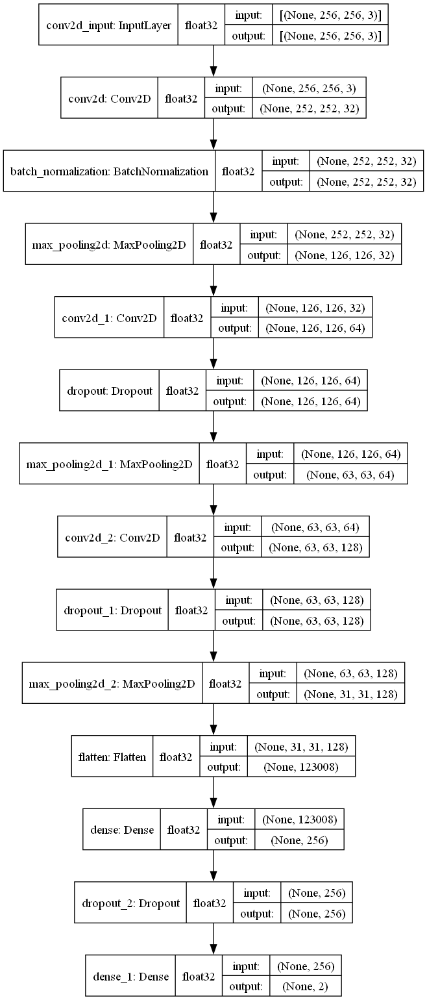

In [81]:
plot_model(Model,to_file="Model_One.png",show_layer_names=True,show_dtype=True,show_shapes=True)

In [82]:
Model_Results = Model.evaluate(Test_IMG_Set)
print("LOSS:  " + "%.4f" % Model_Results[0])
print("ACCURACY:  " + "%.2f" % Model_Results[1])

4/4 [==============================] - 2s 435ms/step - loss: 0.3140 - accuracy: 0.8800
LOSS:  0.3140
ACCURACY:  0.88


No handles with labels found to put in legend.


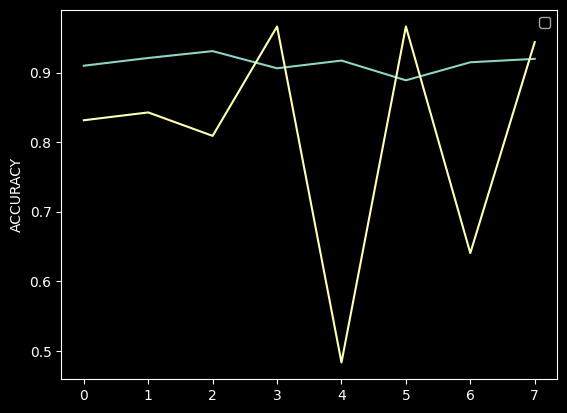

In [83]:
plt.plot(CNN_Model.history["accuracy"])
plt.plot(CNN_Model.history["val_accuracy"])
plt.ylabel("ACCURACY")
plt.legend()
plt.show()

No handles with labels found to put in legend.


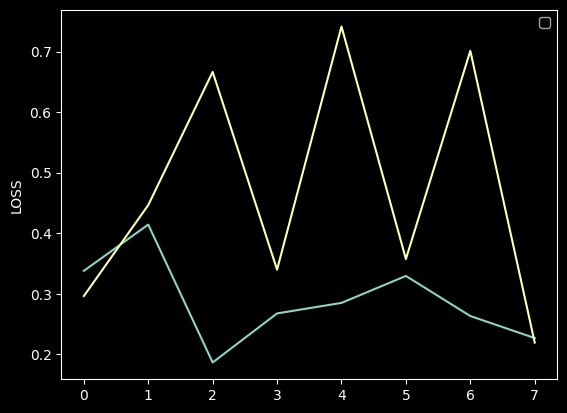

In [84]:
plt.plot(CNN_Model.history["loss"])
plt.plot(CNN_Model.history["val_loss"])
plt.ylabel("LOSS")
plt.legend()
plt.show()

No handles with labels found to put in legend.


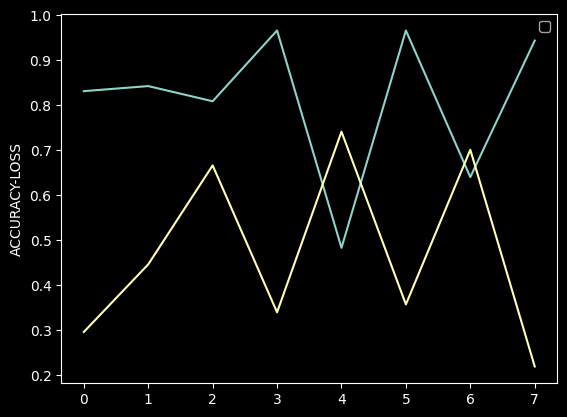

In [85]:
plt.plot(CNN_Model.history["val_accuracy"])
plt.plot(CNN_Model.history["val_loss"])
plt.ylabel("ACCURACY-LOSS")
plt.legend()
plt.show()

<AxesSubplot:>

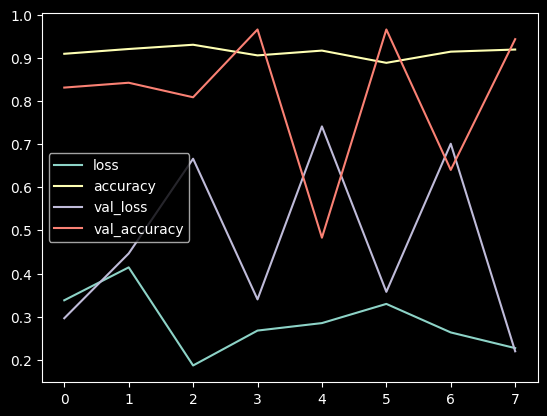

In [86]:
Dict_Summary_One = pd.DataFrame(CNN_Model.history)
Dict_Summary_One.plot()

#### 预测

In [87]:
Prediction_One = Model.predict(Test_IMG_Set)
Prediction_One = Prediction_One.argmax(axis=-1)

In [88]:
print(Prediction_One)

[0 0 0 0 1 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 1 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 1 0 0 0 0 0 1 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 0]


In [89]:
Predict_Class = Model.predict_classes(Test_IMG_Set)

In [90]:
print(Predict_Class)

[0 1 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0
 1 0 0 1 0 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 1 0 0 0 0 1 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


* {'火灾': 0, '非火灾': 1}

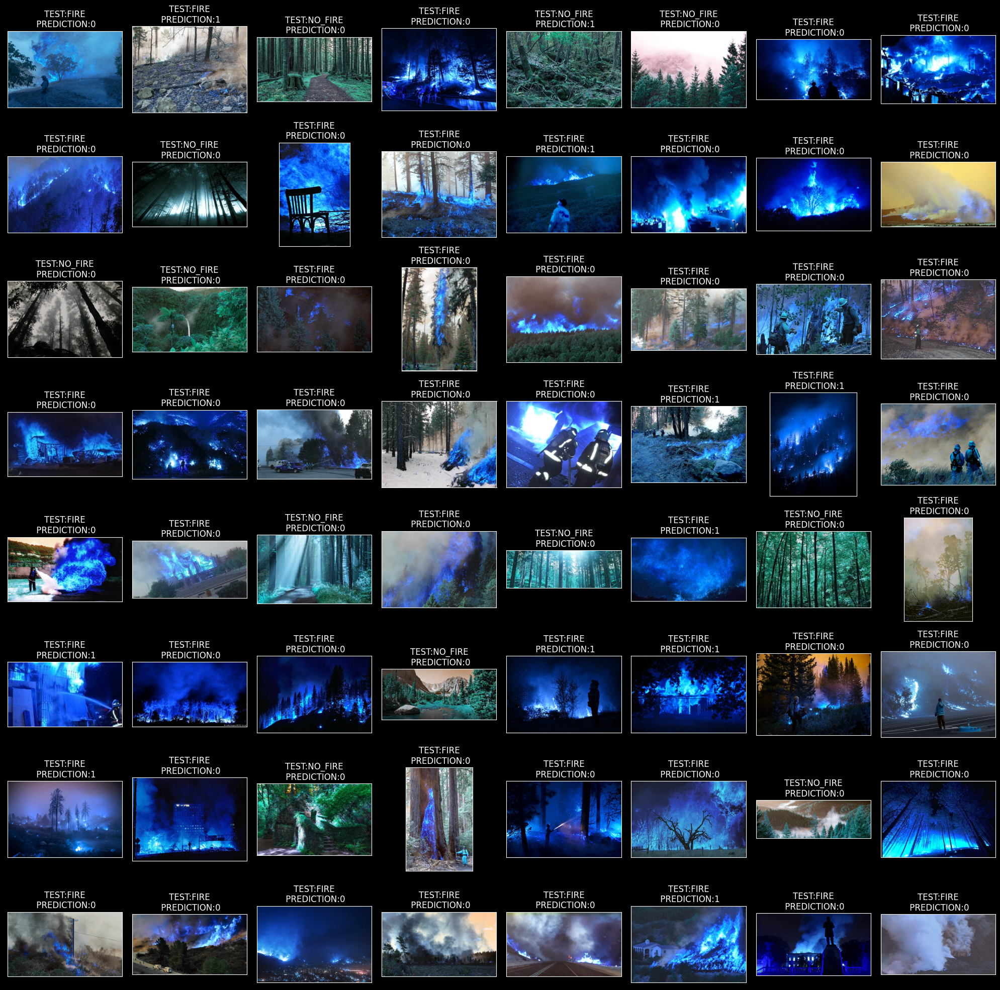

In [91]:
fig, axes = plt.subplots(nrows=8,
                         ncols=8,
                         figsize=(20, 20),
                        subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
    ax.imshow(cv2.imread(Test_Data["PNG"].iloc[i]))
    ax.set_title(f"TEST:{Test_Data.CATEGORY.iloc[i]}\n PREDICTION:{Predict_Class[i]}")
plt.tight_layout()
plt.show()

#### 分类报告和混淆矩阵

In [92]:
print(confusion_matrix(For_Prediction_Class,Predict_Class))

[[64 11]
 [23  2]]


In [93]:
print(classification_report(For_Prediction_Class,Predict_Class))

              precision    recall  f1-score   support

           0       0.74      0.85      0.79        75
           1       0.15      0.08      0.11        25

    accuracy                           0.66       100
   macro avg       0.44      0.47      0.45       100
weighted avg       0.59      0.66      0.62       100



#### 不同数据集的预测

* 火灾

In [94]:
image_path = "./input/test-dataset/Fire-Detection/1/12.jpg"
img = image.load_img(image_path,target_size=(256,256))
x = image.img_to_array(img)
x = np.expand_dims(x,axis=0)

In [95]:
Diff_Pred = Model.predict(x)
Diff_Pred = Diff_Pred.argmax(axis=-1)
print(Diff_Pred)

[0]


* 非火灾

In [96]:
image_path_Two = "./input/test-dataset/Fire-Detection/0/12.jpg"
img_Two = image.load_img(image_path_Two,target_size=(256,256))
x_Two = image.img_to_array(img_Two)
x_Two = np.expand_dims(x_Two,axis=0)

In [97]:
Diff_Pred_Two = Model.predict(x_Two)
Diff_Pred_Two = Diff_Pred_Two.argmax(axis=-1)
print(Diff_Pred_Two)

[0]


In [67]:
Model.save('Model_One.h5')

# 全连接神经网络

In [68]:
Model_Two = tf.keras.models.Sequential([
  # inputs 
  tf.keras.layers.experimental.preprocessing.Rescaling(1./255),
  tf.keras.layers.Flatten(input_shape=(256,)),
  # hiddens layers
  tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dense(64, activation='relu'),
  tf.keras.layers.Dropout(0.2),
  # output layer
  tf.keras.layers.Dense(2,activation="softmax")
])

In [69]:
Model_Two.compile(optimizer = 'adam' , loss = 'categorical_crossentropy' , metrics = ['accuracy'])

In [70]:
ANN_Model = Model_Two.fit(Train_IMG_Set,
                          validation_data=Validation_IMG_Set,
                          callbacks=Call_Back,
                      epochs=10)

Epoch 1/10
26/26 [==============================] - 22s 853ms/step - loss: 0.5692 - accuracy: 0.7241 - val_loss: 0.3834 - val_accuracy: 0.8315
Epoch 2/10
26/26 [==============================] - 20s 784ms/step - loss: 0.3640 - accuracy: 0.8391 - val_loss: 0.3912 - val_accuracy: 0.7978
Epoch 3/10
26/26 [==============================] - 20s 778ms/step - loss: 0.3535 - accuracy: 0.8383 - val_loss: 0.2746 - val_accuracy: 0.9213
Epoch 4/10
26/26 [==============================] - 21s 809ms/step - loss: 0.2795 - accuracy: 0.8954 - val_loss: 0.2040 - val_accuracy: 0.8989
Epoch 5/10
26/26 [==============================] - 21s 798ms/step - loss: 0.2723 - accuracy: 0.9022 - val_loss: 0.2081 - val_accuracy: 0.9101
Epoch 6/10
26/26 [==============================] - 20s 784ms/step - loss: 0.2051 - accuracy: 0.9249 - val_loss: 0.2245 - val_accuracy: 0.9213
Epoch 7/10
26/26 [==============================] - 21s 833ms/step - loss: 0.1967 - accuracy: 0.9189 - val_loss: 0.1802 - val_accuracy: 0.9551

#### 检查

In [71]:
print(Model_Two.summary())

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
rescaling (Rescaling)        (None, None, None, None)  0         
_________________________________________________________________
flatten_1 (Flatten)          (None, None)              0         
_________________________________________________________________
dense_2 (Dense)              (None, 128)               25165952  
_________________________________________________________________
dense_3 (Dense)              (None, 64)                8256      
_________________________________________________________________
dropout_3 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_4 (Dense)              (None, 2)                 130       
Total params: 25,174,338
Trainable params: 25,174,338
Non-trainable params: 0
__________________________________________

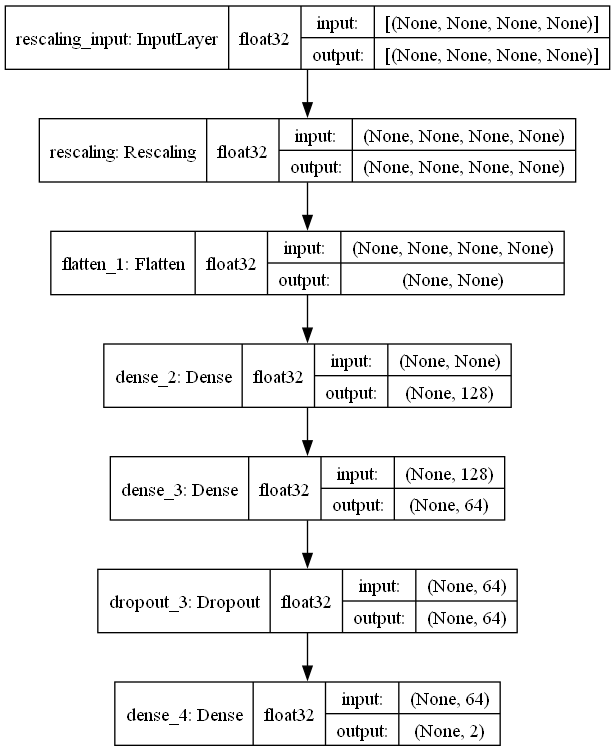

In [72]:
plot_model(Model_Two,to_file="Model_Two.png",show_layer_names=True,show_dtype=True,show_shapes=True)

In [73]:
Model_Results_Two = Model_Two.evaluate(Test_IMG_Set)
print("LOSS:  " + "%.4f" % Model_Results_Two[0])
print("ACCURACY:  " + "%.2f" % Model_Results_Two[1])

4/4 [==============================] - 1s 322ms/step - loss: 0.2974 - accuracy: 0.9100
LOSS:  0.2974
ACCURACY:  0.91


No handles with labels found to put in legend.


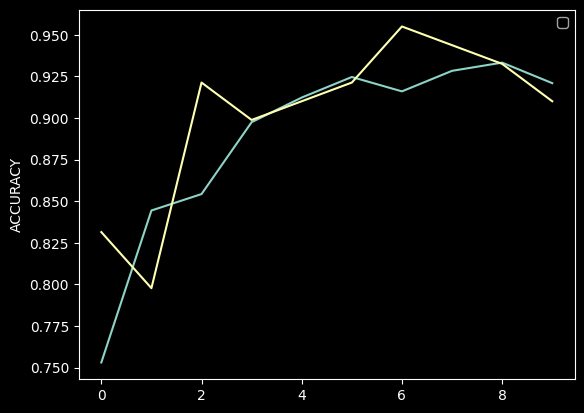

In [74]:
plt.plot(ANN_Model.history["accuracy"])
plt.plot(ANN_Model.history["val_accuracy"])
plt.ylabel("ACCURACY")
plt.legend()
plt.show()

No handles with labels found to put in legend.


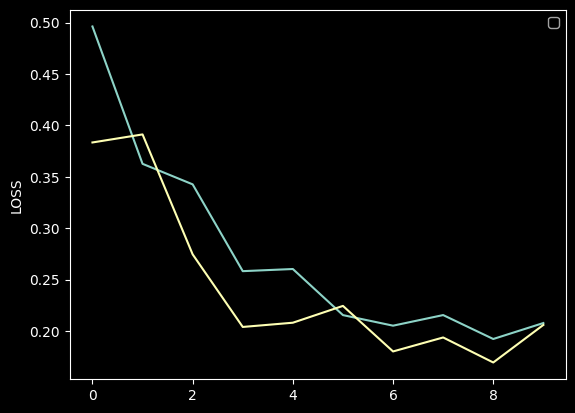

In [75]:
plt.plot(ANN_Model.history["loss"])
plt.plot(ANN_Model.history["val_loss"])
plt.ylabel("LOSS")
plt.legend()
plt.show()

No handles with labels found to put in legend.


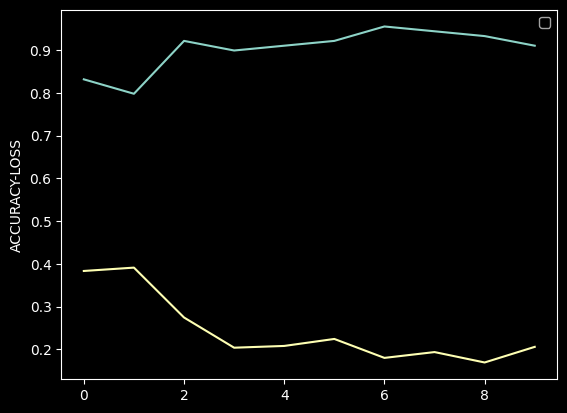

In [76]:
plt.plot(ANN_Model.history["val_accuracy"])
plt.plot(ANN_Model.history["val_loss"])
plt.ylabel("ACCURACY-LOSS")
plt.legend()
plt.show()

<AxesSubplot:>

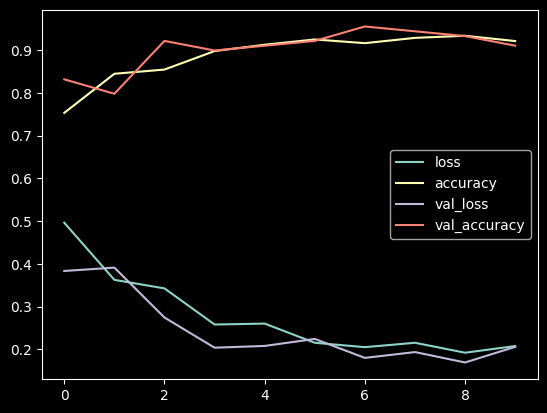

In [77]:
Dict_Summary_Two = pd.DataFrame(ANN_Model.history)
Dict_Summary_Two.plot()

#### 预测

In [57]:
Prediction_Two = Model_Two.predict(Test_IMG_Set)
Prediction_Two = Prediction_Two.argmax(axis=-1)

In [58]:
print(Prediction_Two)

[1 0 1 0 1 0 0 0 1 1 0 0 0 0 1 0 0 0 0 1 0 0 1 1 1 1 0 0 1 0 1 0 0 1 1 1 0
 1 0 0 0 1 0 1 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 1 1 0 0 0 0 0 0 1 0 1 0 1 0 1
 1 1 0 1 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


In [59]:
Prediction_Class_Two = Model_Two.predict_classes(Test_IMG_Set)

In [60]:
print(Prediction_Class_Two)

[0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 1 1 0 0 0 0 1 1 0 0 0 1 1 0 1
 1 0 0 0 0 0 1 1 0 1 0 1 0 1 0 0 1 0 1 1 0 0 1 1 0 0 0 1 0 1 1 0 0 1 0 0 0
 1 0 0 1 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0]


* {'火灾': 0, '非火灾': 1}

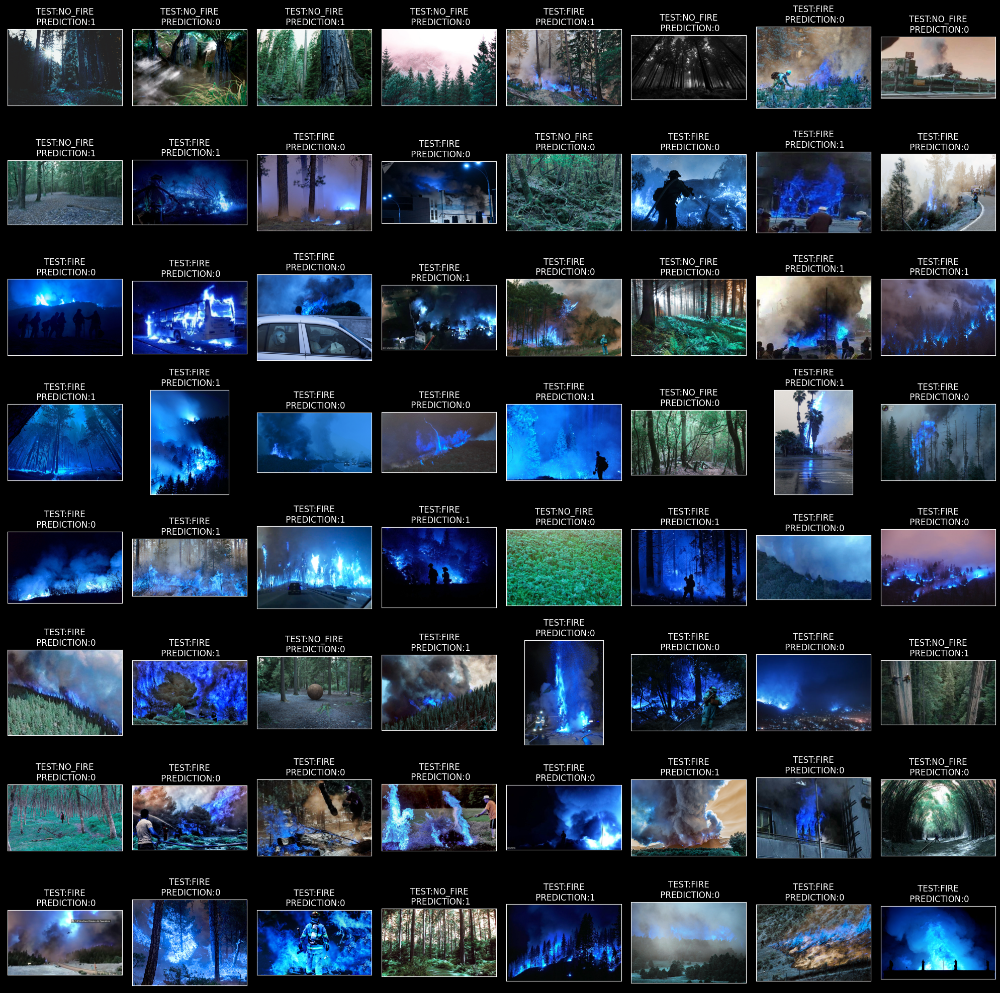

In [61]:
fig, axes = plt.subplots(nrows=8,
                         ncols=8,
                         figsize=(20, 20),
                        subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
    ax.imshow(cv2.imread(Test_Data["PNG"].iloc[i]))
    ax.set_title(f"TEST:{Test_Data.CATEGORY.iloc[i]}\n PREDICTION:{Prediction_Two[i]}")
plt.tight_layout()
plt.show()

#### 分类报告和混淆矩阵

In [62]:
print(confusion_matrix(For_Prediction_Class,Prediction_Class_Two))

[[54 23]
 [14  9]]


In [63]:
print(classification_report(For_Prediction_Class,Prediction_Class_Two))

              precision    recall  f1-score   support

           0       0.79      0.70      0.74        77
           1       0.28      0.39      0.33        23

    accuracy                           0.63       100
   macro avg       0.54      0.55      0.54       100
weighted avg       0.68      0.63      0.65       100



#### 不同数据集的预测

* 火灾

In [67]:
image_path = "./input/test-dataset/Fire-Detection/1/12.jpg"
img = image.load_img(image_path,target_size=(256,256))
x = image.img_to_array(img)
x = np.expand_dims(x,axis=0)

In [68]:
Diff_Pred = Model_Two.predict(x)
Diff_Pred = Diff_Pred.argmax(axis=-1)
print(Diff_Pred)

[0]


* 非火灾

In [70]:
image_path_Two = "./input/test-dataset/Fire-Detection/0/12.jpg"
img_Two = image.load_img(image_path_Two,target_size=(256,256))
x_Two = image.img_to_array(img_Two)
x_Two = np.expand_dims(x_Two,axis=0)

In [71]:
Diff_Pred_Two = Model_Two.predict(x_Two)
Diff_Pred_Two = Diff_Pred_Two.argmax(axis=-1)
print(Diff_Pred_Two)

[1]


In [164]:
Model_Two.save('Model_Two.h5')

# R-CNN

In [98]:
Model_Three = Sequential()

Model_Three.add(Conv2D(12,(3,3),activation="relu",
                 input_shape=(256,256,3)))
Model_Three.add(BatchNormalization())
Model_Three.add(MaxPooling2D((2,2)))

#
Model_Three.add(Conv2D(24,(3,3),
                 activation="relu"))
Model_Three.add(Dropout(0.2))
Model_Three.add(MaxPooling2D((2,2)))


#
Model_Three.add(TimeDistributed(Flatten()))
Model_Three.add(Bidirectional(LSTM(32,
                                  return_sequences=True,
                                  dropout=0.5,
                                  recurrent_dropout=0.5)))
Model_Three.add(Bidirectional(GRU(32,
                                  return_sequences=True,
                                  dropout=0.5,
                                  recurrent_dropout=0.5)))

#
Model_Three.add(Flatten())

Model_Three.add(Dense(256,activation="relu"))
Model_Three.add(Dropout(0.5))
Model_Three.add(Dense(2,activation="softmax"))

In [99]:
Model_Three.compile(optimizer = 'adam' , loss = 'categorical_crossentropy' , metrics = ['accuracy'])

In [130]:
RCNN_Model = Model_Three.fit(Train_IMG_Set,
                          validation_data=Validation_IMG_Set,
                          callbacks=Call_Back,
                      epochs=10)

Epoch 1/20
26/26 [==============================] - 45s 2s/step - loss: 0.1382 - accuracy: 0.9642 - val_loss: 0.1095 - val_accuracy: 0.9888
Epoch 2/20
26/26 [==============================] - 43s 2s/step - loss: 0.1081 - accuracy: 0.9667 - val_loss: 0.0733 - val_accuracy: 0.9663
Epoch 3/20
26/26 [==============================] - 43s 2s/step - loss: 0.1161 - accuracy: 0.9556 - val_loss: 0.0853 - val_accuracy: 0.9663
Epoch 4/20
26/26 [==============================] - 43s 2s/step - loss: 0.1089 - accuracy: 0.9568 - val_loss: 0.0357 - val_accuracy: 0.9888
Epoch 5/20
26/26 [==============================] - 43s 2s/step - loss: 0.0914 - accuracy: 0.9679 - val_loss: 0.0506 - val_accuracy: 0.9888
Epoch 6/20
26/26 [==============================] - 43s 2s/step - loss: 0.1126 - accuracy: 0.9568 - val_loss: 0.1470 - val_accuracy: 0.9438
Epoch 7/20
26/26 [==============================] - 44s 2s/step - loss: 0.1240 - accuracy: 0.9543 - val_loss: 0.1158 - val_accuracy: 0.9663
Epoch 8/20
26/26 [==

In [131]:
print(Model_Three.summary())

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 254, 254, 12)      336       
_________________________________________________________________
batch_normalization_1 (Batch (None, 254, 254, 12)      48        
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 127, 127, 12)      0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 125, 125, 24)      2616      
_________________________________________________________________
dropout_4 (Dropout)          (None, 125, 125, 24)      0         
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 62, 62, 24)        0         
_________________________________________________________________
time_distributed (TimeDistri (None, 62, 1488)         

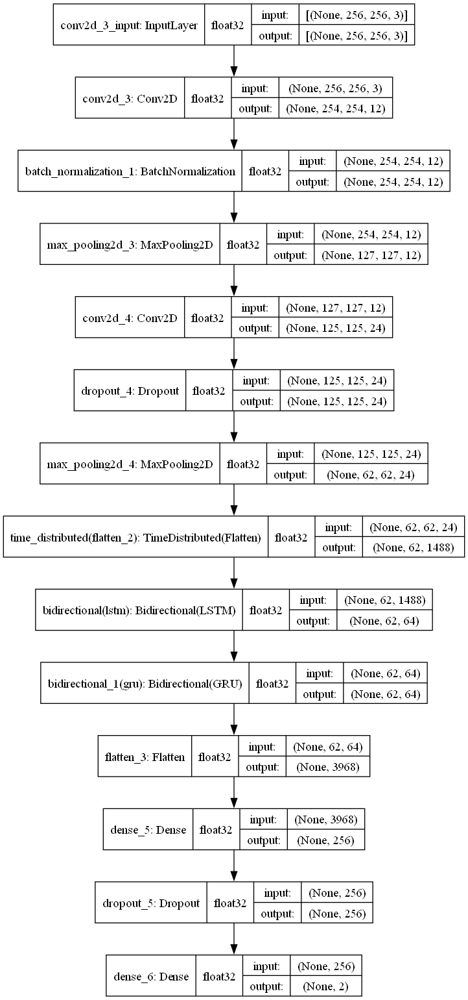

In [132]:
plot_model(Model_Three,to_file="Model_Three.png",show_layer_names=True,show_dtype=True,show_shapes=True)

In [133]:
Model_Results_Three = Model_Three.evaluate(Test_IMG_Set)
print("LOSS:  " + "%.4f" % Model_Results_Three[0])
print("ACCURACY:  " + "%.2f" % Model_Results_Three[1])

4/4 [==============================] - 2s 261ms/step - loss: 0.0883 - accuracy: 0.9600
LOSS:  0.0883
ACCURACY:  0.96


No handles with labels found to put in legend.


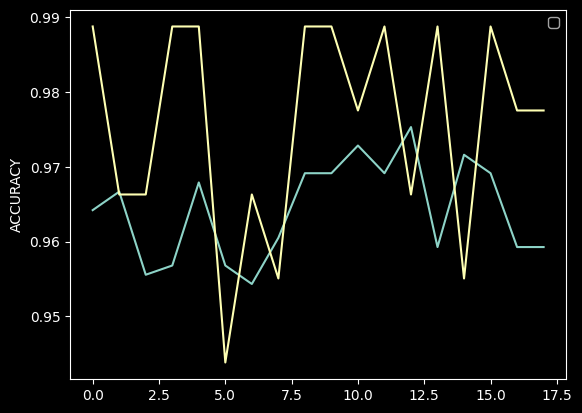

In [134]:
plt.plot(RCNN_Model.history["accuracy"])
plt.plot(RCNN_Model.history["val_accuracy"])
plt.ylabel("ACCURACY")
plt.legend()
plt.show()

No handles with labels found to put in legend.


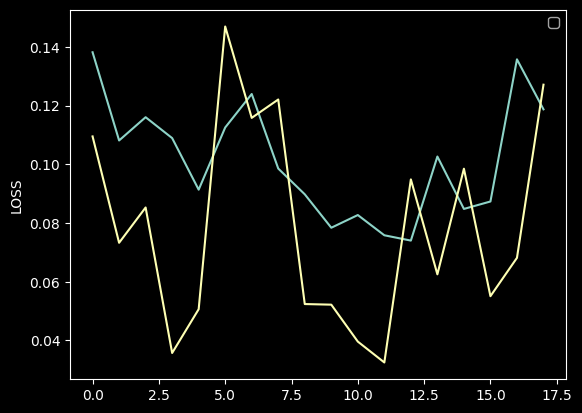

In [135]:
plt.plot(RCNN_Model.history["loss"])
plt.plot(RCNN_Model.history["val_loss"])
plt.ylabel("LOSS")
plt.legend()
plt.show()

No handles with labels found to put in legend.


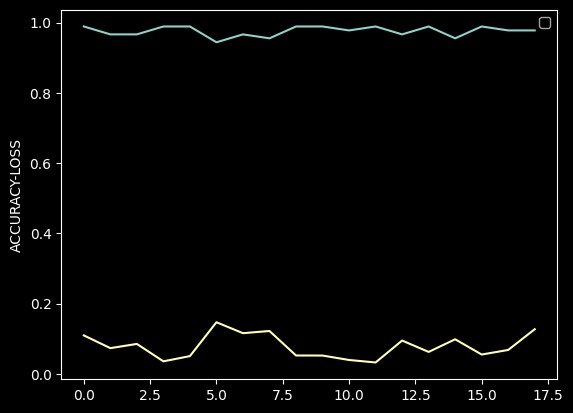

In [136]:
plt.plot(RCNN_Model.history["val_accuracy"])
plt.plot(RCNN_Model.history["val_loss"])
plt.ylabel("ACCURACY-LOSS")
plt.legend()
plt.show()

<AxesSubplot:>

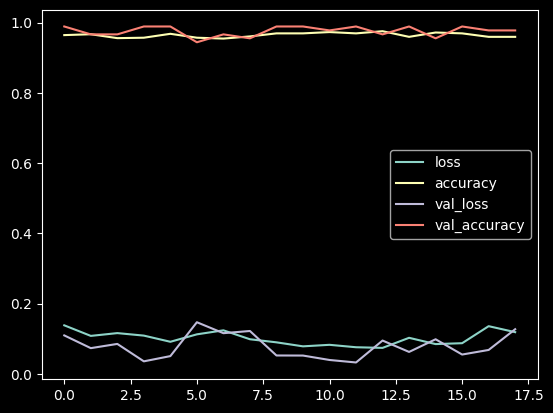

In [137]:
Dict_Summary_Three = pd.DataFrame(RCNN_Model.history)
Dict_Summary_Three.plot()

In [138]:
Prediction_Three = Model_Three.predict(Test_IMG_Set)
Prediction_Three = Prediction_Three.argmax(axis=-1)

In [139]:
print(Prediction_Three)

[1 0 0 0 0 1 1 0 0 0 1 1 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0
 0 1 0 0 0 0 0 1 1 0 0 0 0 1 0 0 0 1 0 0 0 0 0 1 1 0 0 0 1 0 0 0 0 0 0 0 1
 0 1 0 1 0 0 0 1 0 1 0 0 0 0 0 1 1 0 1 0 1 0 0 0 0 0]


* {'火灾': 0, '非火灾': 1}

In [140]:
Prediction_Class_Three = Model_Three.predict_classes(Test_IMG_Set)

In [141]:
print(Prediction_Class_Three)

[0 0 0 0 0 0 0 0 1 0 1 0 1 0 0 0 0 1 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0
 0 0 0 1 1 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 1 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0
 1 0 1 0 0 1 1 0 0 0 1 0 0 1 0 0 0 0 1 0 0 1 0 1 1 1]


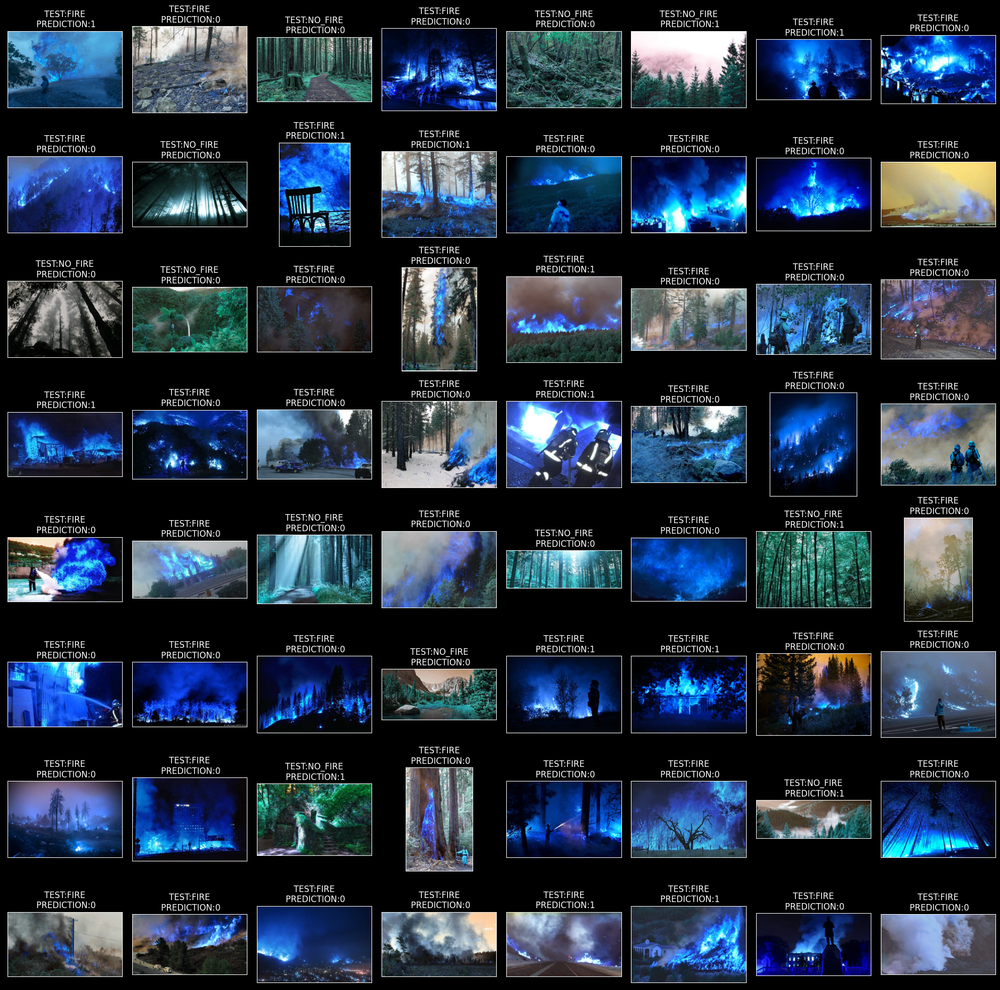

In [142]:
fig, axes = plt.subplots(nrows=8,
                         ncols=8,
                         figsize=(20, 20),
                        subplot_kw={'xticks': [], 'yticks': []})

for i, ax in enumerate(axes.flat):
    ax.imshow(cv2.imread(Test_Data["PNG"].iloc[i]))
    ax.set_title(f"TEST:{Test_Data.CATEGORY.iloc[i]}\n PREDICTION:{Prediction_Three[i]}")
plt.tight_layout()
plt.show()

#### 分类报告和混淆矩阵

In [143]:
print(classification_report(For_Prediction_Class,Prediction_Three))

              precision    recall  f1-score   support

           0       0.79      0.79      0.79        75
           1       0.36      0.36      0.36        25

    accuracy                           0.68       100
   macro avg       0.57      0.57      0.57       100
weighted avg       0.68      0.68      0.68       100



In [129]:
print(confusion_matrix(For_Prediction_Class,Prediction_Three))

[[46 29]
 [22  3]]


##### 不同数据集的预测

* 火灾

In [91]:
image_path = "./input/test-dataset/Fire-Detection/1/12.jpg"
img = image.load_img(image_path,target_size=(256,256))
x = image.img_to_array(img)
x = np.expand_dims(x,axis=0)

In [92]:
Diff_Pred = Model_Three.predict(x)
Diff_Pred = Diff_Pred.argmax(axis=-1)
print(Diff_Pred)

[0]


[0]

* 非火灾

In [94]:
image_path_Two = "./input/test-dataset/Fire-Detection/0/12.jpg"
img_Two = image.load_img(image_path_Two,target_size=(256,256))
x_Two = image.img_to_array(img_Two)
x_Two = np.expand_dims(x_Two,axis=0)

In [95]:
Diff_Pred_Three = Model_Three.predict(x)
Diff_Pred_Three = Diff_Pred_Three.argmax(axis=-1)
print(Diff_Pred_Three)

[0]


In [165]:
Model_Three.save('Model_Three.h5')